# 

In [1]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import random
import math

### Passo 1: Carregar a imagem

In [2]:
# imagem = Image.open('playboy.png')
imagem = Image.open('lenna.jpg')

### Passo 2: Converter para escala de cinza

In [3]:
imagem_cinza = imagem.convert('L')

### Passo 3: Converter a imagem para um array NumPy

In [4]:
valores_pixels = np.array(imagem_cinza)

### Passo 4: Obter o array de valores 1D e normalizar de 0 a 1

In [5]:
valores_pixels_1d = valores_pixels.flatten() / 255
# valores_pixels_1d = valores_pixels.flatten() 

### Passo 5: Calcular a média e o desvio padrão dos valores dos pixels

In [6]:
media = np.mean(valores_pixels_1d)
desvio_padrao = np.std(valores_pixels_1d)

# Exibir os resultados
print("Tamanho da Imagem:", imagem_cinza.size)
print("Média:", media)
print("Desvio Padrão:", desvio_padrao)

Tamanho da Imagem: (512, 512)
Média: 0.48646373374789376
Desvio Padrão: 0.18716595137992745


### Passo 6: Construir e normalizar o vetor x com níveis de cinza de -1 até 1

In [7]:
x = np.linspace(-1, 1, 511)
x

array([-1.        , -0.99607843, -0.99215686, -0.98823529, -0.98431373,
       -0.98039216, -0.97647059, -0.97254902, -0.96862745, -0.96470588,
       -0.96078431, -0.95686275, -0.95294118, -0.94901961, -0.94509804,
       -0.94117647, -0.9372549 , -0.93333333, -0.92941176, -0.9254902 ,
       -0.92156863, -0.91764706, -0.91372549, -0.90980392, -0.90588235,
       -0.90196078, -0.89803922, -0.89411765, -0.89019608, -0.88627451,
       -0.88235294, -0.87843137, -0.8745098 , -0.87058824, -0.86666667,
       -0.8627451 , -0.85882353, -0.85490196, -0.85098039, -0.84705882,
       -0.84313725, -0.83921569, -0.83529412, -0.83137255, -0.82745098,
       -0.82352941, -0.81960784, -0.81568627, -0.81176471, -0.80784314,
       -0.80392157, -0.8       , -0.79607843, -0.79215686, -0.78823529,
       -0.78431373, -0.78039216, -0.77647059, -0.77254902, -0.76862745,
       -0.76470588, -0.76078431, -0.75686275, -0.75294118, -0.74901961,
       -0.74509804, -0.74117647, -0.7372549 , -0.73333333, -0.72

### Funçôes para adicionar ruídos

In [8]:
# Função para calcular a distribuição de Poisson
# x = np.linspace(-255, 255, 511)
def poisson_pdf():
    pdf_values = []
    for i in x:
        if i <= 0:
           pdf_values.append(0)
        elif i == 0:
              pdf_values.append(np.exp(-media) * media** i)
        else:
             pdf_values.append((np.exp(-media) * media** i) / math.gamma(i))
            #   pdf_values.append((np.exp(-media) * media** i) / math.factorial(i))

    return pdf_values

### Passo 7: Calcular a função de densidade de probabilidade (FDP) para o ruído gaussiano

In [9]:
# Calcula e substitui os valores
pdf_values = poisson_pdf()
print(pdf_values)


[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.0024095815746127155, 0.004816272321195646, 0.007219894268094499, 0.00962027125150509, 0.012017228915089814, 0.014410594709396807, 0.01680019789108435, 0.019185869521953093, 0.02156744246778857, 0.02394475139701677, 0.026317632779

### Passo 8: Calcular a função densidade acumulada (FDA) como a soma cumulativa da FDP

In [10]:
fda_values = np.cumsum(pdf_values)

### Passo 9: Normalizar a FDA para que o último valor seja 1

In [11]:
fda_values /= fda_values[-1]

### Plotando os graficos

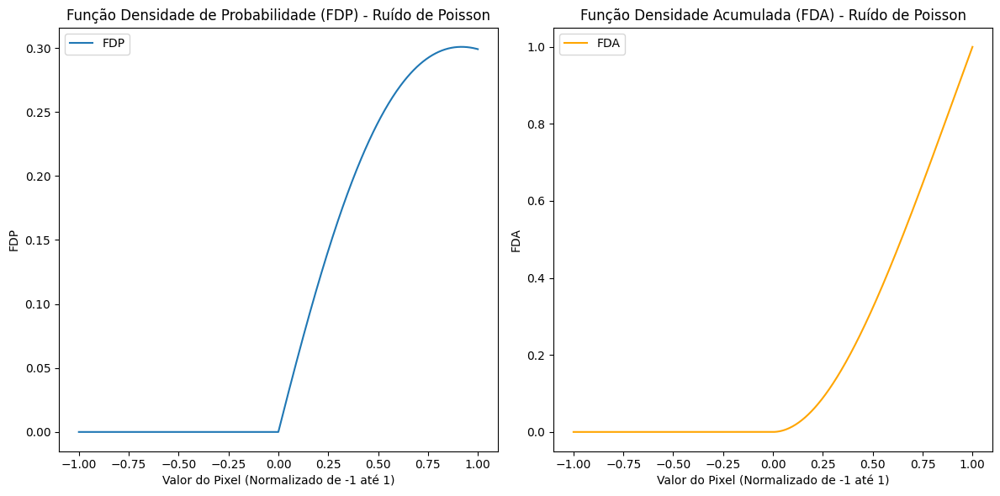

In [12]:
# Plotar a FDP e a FDA
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(x, pdf_values, label="FDP")
plt.title("Função Densidade de Probabilidade (FDP) - Ruído de Poisson")
plt.xlabel("Valor do Pixel (Normalizado de -1 até 1)")
plt.ylabel("FDP")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(x, fda_values, label="FDA", color="orange")
plt.title("Função Densidade Acumulada (FDA) - Ruído de Poisson")
plt.xlabel("Valor do Pixel (Normalizado de -1 até 1)")
plt.ylabel("FDA")
plt.legend()

plt.tight_layout()
plt.show()

# Passo 10: Gerar valores de FDA aleatórios e modificar os valores dos pixels

In [13]:
num = np.random.uniform(0, 1, valores_pixels.size)

### Encontrndo nivel de cinza

In [14]:
def encontrar_nivel_cinza(fda, x, valor_fda_desejado):
    # Encontra o índice do valor de FDA mais próximo
    idx = np.searchsorted(fda, valor_fda_desejado, side='left')
    # Se o índice estiver fora dos limites, ajusta
    if idx >= len(x):
        idx = len(x) - 1
    if idx < 0:
        idx = 0
    return x[idx]

### Criação de um novo array para armazenar os valores de pixels modificados

In [15]:
valores_pixels_1d_modificado = valores_pixels_1d.copy()

for i in range(valores_pixels.size):
    # val = num[i]

    valor_fda_desejado = np.random.uniform(0, 1) 
    
    # Encontrar o valor de nível de cinza para um valor específico de FDA
    nivel_cinza = encontrar_nivel_cinza(fda_values, x, valor_fda_desejado) * 0.09

    print(f"Nível de cinza correspondente ao valor FDA = {valor_fda_desejado}: {nivel_cinza}")

    # valores_pixels_1d_modificado[i] = nivel_cinza
    
    # if valores_pixels_1d_modificado[i] + nivel_cinza > 1:
    #      valores_pixels_1d_modificado[i] -= nivel_cinza
    # else:
    #     valores_pixels_1d_modificado[i] += nivel_cinza
    
    valores_pixels_1d_modificado[i] += nivel_cinza
    
    # if valores_pixels_1d_modificado[i] > 1:
    #      valores_pixels_1d_modificado[i] = 1
    # if valores_pixels_1d_modificado[i] < 0:
    #     valores_pixels_1d_modificado[i] = 0

valores_pixels_1d_modificado = (valores_pixels_1d_modificado * 255)

Nível de cinza correspondente ao valor FDA = 0.6999141994943432: 0.07129411764705883
Nível de cinza correspondente ao valor FDA = 0.2279278351630648: 0.03741176470588236
Nível de cinza correspondente ao valor FDA = 0.6412794177073636: 0.06741176470588235
Nível de cinza correspondente ao valor FDA = 0.7581680805867297: 0.07482352941176469
Nível de cinza correspondente ao valor FDA = 0.7477513343165568: 0.07411764705882352
Nível de cinza correspondente ao valor FDA = 0.10996737752700247: 0.025411764705882342
Nível de cinza correspondente ao valor FDA = 0.5552668278191998: 0.06176470588235294
Nível de cinza correspondente ao valor FDA = 0.05981738898539135: 0.01870588235294117
Nível de cinza correspondente ao valor FDA = 0.16444681004602424: 0.03141176470588236
Nível de cinza correspondente ao valor FDA = 0.4595632009392058: 0.055411764705882355
Nível de cinza correspondente ao valor FDA = 0.053215673033449096: 0.01729411764705882
Nível de cinza correspondente ao valor FDA = 0.92858039436

### Passo 11: Converter o array 1D modificado de volta para uma imagem

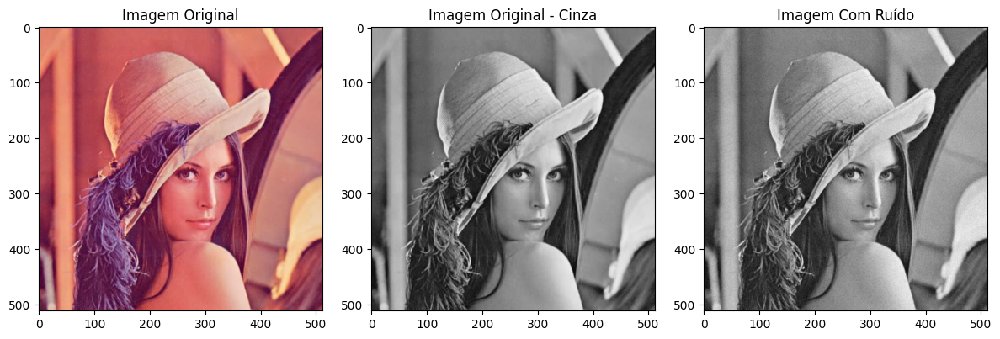

In [26]:
valores_pixels_modificado = valores_pixels_1d_modificado.reshape(valores_pixels.shape)
imagem_modificada = Image.fromarray(valores_pixels_modificado.astype(np.uint8))

# Exibir a imagem original e modificada lado a lado
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(imagem, cmap="gray")
plt.title("Imagem Original")

plt.subplot(1, 3, 2)
plt.imshow(imagem_cinza, cmap="gray")
plt.title("Imagem Original - Cinza")

plt.subplot(1, 3, 3)
plt.imshow(imagem_modificada, cmap="gray")
plt.title("Imagem Com Ruído")

plt.tight_layout()
plt.show()

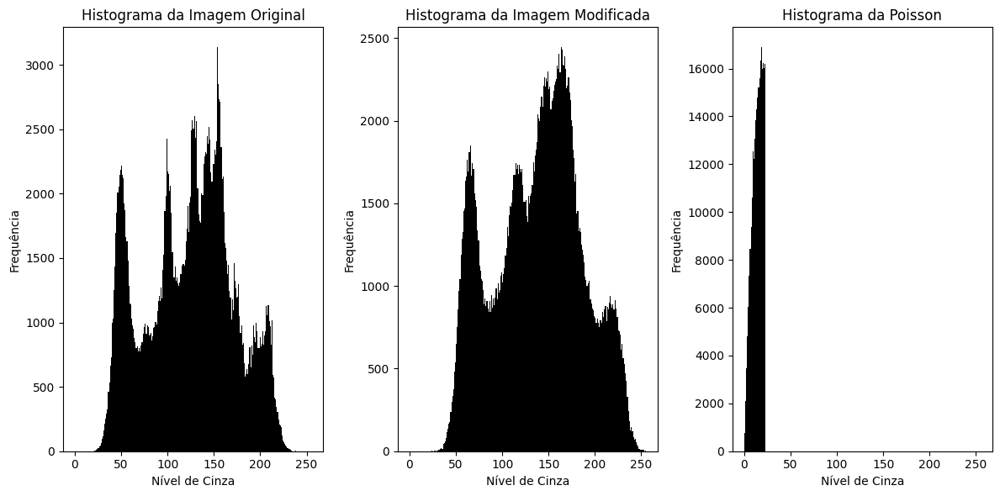

In [23]:
# Exibir a imagem original e modificada lado a lado
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.hist(valores_pixels.flatten(), bins=256, range=(0, 255), color='black')
plt.title("Histograma da Imagem Original")
plt.xlabel("Nível de Cinza")
plt.ylabel("Frequência")

plt.subplot(1, 3, 2)
plt.hist(valores_pixels_modificado.flatten(), bins=255, range=(0, 255), color='black')
plt.title("Histograma da Imagem Modificada")
plt.xlabel("Nível de Cinza")
plt.ylabel("Frequência")

aux = abs(valores_pixels - valores_pixels_modificado)

plt.subplot(1, 3, 3)
plt.hist(aux.flatten(), bins=255, range=(0, 255), color='black')
plt.title("Histograma da Poisson")
plt.xlabel("Nível de Cinza")
plt.ylabel("Frequência")

plt.tight_layout()
plt.show()